## Bloc 4 - Automatic Fraud Detection

### 1. Import libraries

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import  OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import accuracy_score, f1_score, RocCurveDisplay, ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
import warnings

warnings.filterwarnings("ignore", category=FutureWarning) # to avoid deprecation warnings

# setting Jedha color palette as default
pio.templates["jedha"] = go.layout.Template(
    layout_colorway=["#4B9AC7", "#4BE8E0", "#9DD4F3", "#97FBF6", "#2A7FAF", "#23B1AB", "#0E3449", "#015955"]
)
pio.templates.default = "jedha"
# pio.renderers.default = "svg" # to be replaced by "iframe" if working on JULIE
# pio.renderers.default = "svg" # this line must be commented if working on colab
pio.renderers.default = 'vscode' # pour affichage des graphes dans vscode



#### 2. Import data

In [2]:
pd.options.display.max_columns = None # to avoid the columns to be truncated when displaying a table

print('Loading dataset...')
df = pd.read_csv("../data/fraudTest.csv", index_col=0)
print('...Done!')

Loading dataset...
...Done!


In [3]:
# Basic stats

print("Number of rows: {}".format(df.shape[0]))

print("Display of dataset: ")
display(df.head())
print()

print("Basics statistics:")
df_describe = df.describe(include="all")
display(df_describe)
print()

print("Percentage of missing values: ")
display(100 * df.isnull().sum() / df.shape[0])

print("Percentage of frauds: ")
df_count_fraud = df['is_fraud'].value_counts()
display(100 * df_count_fraud / df.shape[0])

print()


Number of rows: 555719
Display of dataset: 


,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,2020-06-21 12:14:25,2291163933867244,fraud_Kirlin and Sons,personal_care,2.86,Jeff,Elliott,M,351 Darlene Green,Columbia,SC,29209,33.9659,-80.9355,333497,Mechanical engineer,1968-03-19,2da90c7d74bd46a0caf3777415b3ebd3,1371816865,33.986391,-81.200714,0
1,2020-06-21 12:14:33,3573030041201292,fraud_Sporer-Keebler,personal_care,29.84,Joanne,Williams,F,3638 Marsh Union,Altonah,UT,84002,40.3207,-110.4360,302,"Sales professional, IT",1990-01-17,324cc204407e99f51b0d6ca0055005e7,1371816873,39.450498,-109.960431,0
2,2020-06-21 12:14:53,3598215285024754,"fraud_Swaniawski, Nitzsche and Welch",health_fitness,41.28,Ashley,Lopez,F,9333 Valentine Point,Bellmore,NY,11710,40.6729,-73.5365,34496,"Librarian, public",1970-10-21,c81755dbbbea9d5c77f094348a7579be,1371816893,40.495810,-74.196111,0
3,2020-06-21 12:15:15,3591919803438423,fraud_Haley Group,misc_pos,60.05,Brian,Williams,M,32941 Krystal Mill Apt. 552,Titusville,FL,32780,28.5697,-80.8191,54767,Set designer,1987-07-25,2159175b9efe66dc301f149d3d5abf8c,1371816915,28.812398,-80.883061,0
4,2020-06-21 12:15:17,3526826139003047,fraud_Johnston-Casper,travel,3.19,Nathan,Massey,M,5783 Evan Roads Apt. 465,Falmouth,MI,49632,44.2529,-85.0170,1126,Furniture designer,1955-07-06,57ff021bd3f328f8738bb535c302a31b,1371816917,44.959148,-85.884734,0



Basics statistics:


,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,state,zip,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
count,555719,5.557190e+05,555719,555719,555719.000000,555719,555719,555719,555719,555719,555719,555719.000000,555719.000000,555719.000000,5.557190e+05,555719,555719,555719,5.557190e+05,555719.000000,555719.000000,555719.000000
unique,544760,NaN,693,14,NaN,341,471,2,924,849,50,NaN,NaN,NaN,NaN,478,910,555719,NaN,NaN,NaN,NaN
top,2020-10-05 19:37:49,NaN,fraud_Kilback LLC,gas_transport,NaN,Christopher,Smith,F,444 Robert Mews,Birmingham,TX,NaN,NaN,NaN,NaN,Film/video editor,1977-03-23,1765bb45b3aa3224b4cdcb6e7a96cee3,NaN,NaN,NaN,NaN
freq,4,NaN,1859,56370,NaN,11443,12146,304886,1474,2423,40393,NaN,NaN,NaN,NaN,4119,2408,1,NaN,NaN,NaN,NaN
mean,NaN,4.178387e+17,NaN,NaN,69.392810,NaN,NaN,NaN,NaN,NaN,NaN,48842.628015,38.543253,-90.231325,8.822189e+04,NaN,NaN,NaN,1.380679e+09,38.542798,-90.231380,0.003860
std,NaN,1.309837e+18,NaN,NaN,156.745941,NaN,NaN,NaN,NaN,NaN,NaN,26855.283328,5.061336,13.721780,3.003909e+05,NaN,NaN,NaN,5.201104e+06,5.095829,13.733071,0.062008
min,NaN,6.041621e+10,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,1257.000000,20.027100,-165.672300,2.300000e+01,NaN,NaN,NaN,1.371817e+09,19.027422,-166.671575,0.000000
25%,NaN,1.800429e+14,NaN,NaN,9.630000,NaN,NaN,NaN,NaN,NaN,NaN,26292.000000,34.668900,-96.798000,7.410000e+02,NaN,NaN,NaN,1.376029e+09,34.755302,-96.905129,0.000000
50%,NaN,3.521417e+15,NaN,NaN,47.290000,NaN,NaN,NaN,NaN,NaN,NaN,48174.000000,39.371600,-87.476900,2.408000e+03,NaN,NaN,NaN,1.380762e+09,39.376593,-87.445204,0.000000
75%,NaN,4.635331e+15,NaN,NaN,83.010000,NaN,NaN,NaN,NaN,NaN,NaN,72011.000000,41.894800,-80.175200,1.968500e+04,NaN,NaN,NaN,1.385867e+09,41.954163,-80.264637,0.000000



Percentage of missing values: 


trans_date_trans_time    0.0
cc_num                   0.0
merchant                 0.0
category                 0.0
amt                      0.0
first                    0.0
last                     0.0
gender                   0.0
street                   0.0
city                     0.0
state                    0.0
zip                      0.0
lat                      0.0
long                     0.0
city_pop                 0.0
job                      0.0
dob                      0.0
trans_num                0.0
unix_time                0.0
merch_lat                0.0
merch_long               0.0
is_fraud                 0.0
dtype: float64

Percentage of frauds: 


is_fraud
0    99.614014
1     0.385986
Name: count, dtype: float64

In [4]:
# Distribution overview
status = df['is_fraud'].value_counts()
total_transactions = len(df)
total_frauds = status.get(1)
total_no_frauds = status.get(0)
total_fraud_rate  = (total_frauds/total_transactions) * 100
avg_fraud_amt = (df.loc[df['is_fraud'] == 1, 'amt'].sum()) / total_frauds

print(f"Dataset summary :")
print(f"Total transactions : {total_transactions:,}")
print(f"Total no_frauds : {total_no_frauds:,} ({100-total_fraud_rate:.2f}%)")
print(f"Total frauds : {total_frauds:,} ({total_fraud_rate:.2f}%)")
print(f"Average fraud amount : {avg_fraud_amt:.2f}$")


Dataset summary :
Total transactions : 555,719
Total no_frauds : 553,574 (99.61%)
Total frauds : 2,145 (0.39%)
Average fraud amount : 528.36$


In [5]:
fig = px.pie(df, names = 'is_fraud', values = 'amt', title="Repartition by amount")
fig.show()

#### 3. Cleansing data

In [6]:
# Extract information from 'trans_date_trans_time'
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'], format = "%Y-%m-%d %H:%M:%S")
df['weekday'] = df['trans_date_trans_time'].dt.dayofweek + 1 # To start week with monday = 1
df['year'] = df['trans_date_trans_time'].dt.year
df['month'] = df['trans_date_trans_time'].dt.month
df['hour'] = df['trans_date_trans_time'].dt.hour

# Enrichment with period of transaction
# df['period'] = df['hour'].apply(lambda x : 'night' if (x > 0) and (x <= 6) 
#                                 else 'morning' if (x > 6) and (x <= 12)
#                                 else 'afternoon' if (x > 12) and (x <= 18)
#                                 else 'evening')
# display(df.pivot_table(index='hour',columns='period', values='amt', aggfunc='sum'))

# Enrichment with lenght of credit card number
df['cc_num'] = df['cc_num'].astype(str) # integer to string
df['lenght_cc_num'] = df['cc_num'].str.len()
df['lenght_cc_num'] = pd.to_numeric(df['lenght_cc_num'])

# Enrichment with the first 6 characters of cc_num = BIN (Bank Identifier Number) code
# df['BIN'] = [x[:6] for x in df['cc_num']]
# df['BIN'] = pd.to_numeric(df['BIN'])

# Enrichment with the 1st character of cc_num (1 to 9)
    # 1 et 2 pour les compagnies aériennes, 3 pour les organismes de voyages ou de loisirs,
    # 4 et 5 pour les établissements bancaires et financiers, 6 pour le merchandising,
    # 7 pour le pétrole, 8 pour les télécommunications et 9 pour les supports nationaux
# df['provider'] = [x[:1] for x in df['cc_num']]
# df['provider'] = pd.to_numeric(df['provider'])

# Delete 'fraud_' in merchant names
# df["merchant"] = df["merchant"].str.replace("fraud_", "", regex= False)

# Pad '0' on left to have 5 digits
# df['zip'] = df['zip'].astype(str).apply(lambda x: x.zfill(5))

# List of zips
# zips = df['zip'].drop_duplicates().sort_values()
# display(zips)

# Convert date of birthday in age
df['dob'] = pd.to_datetime(df['dob'], format = "%Y-%m-%d")
def from_dob_to_age(dob):
    today = pd.to_datetime('today').date()
    return today.year - dob.year - ((today.month, today.day) < (dob.month, dob.day))
df['age'] = df['dob'].apply(lambda x: from_dob_to_age(x))

# Enrichment with distance (kms) between customer and merchant
def haversine(long, merch_long, lat, merch_lat):
    long, merch_long, lat, merch_lat = map(np.radians, [long, merch_long, lat, merch_lat])  # Convert degrees to radians
    diff_lon = merch_long - long
    diff_lat = merch_lat - lat
    distance_km = 2*6371*np.arcsin(np.sqrt(np.sin(diff_lat/2.0)**2 + np.cos(lat) * np.cos(merch_lat) * np.sin(diff_lon/2.0)**2)) # earth radius: 6371 kms
    return distance_km
df.loc[:, 'distance_km'] = df.apply(lambda x: haversine(x['long'], x['merch_long'], x['lat'], x['merch_lat']), axis = 1)

# Anonymize (because of compliance) and drop useless data (or too many categories)
# useless_columns= ['trans_date_trans_time', 'cc_num', 'merchant', 'first', 'last', 'street', 'city', 'zip', 'lat', 'long',
#                  'job', 'dob', 'trans_num', 'unix_time', 'merch_lat', 'merch_long']
useless_columns= ['cc_num', 'merchant', 'first', 'last', 'street', 'city', 'zip', 'job', 'dob', 'trans_num', 'unix_time']
df = df.drop(useless_columns, axis= 'columns')

# Convert to float all numeric features
# df = df.astype({col: "float64" for col in df.select_dtypes(include=["int"]).columns})

In [7]:
max = df['trans_date_trans_time'].max()
max

Timestamp('2020-12-31 23:59:34')

In [8]:
min = df['trans_date_trans_time'].min()
min

Timestamp('2020-06-21 12:14:25')

In [9]:
df.head()

,trans_date_trans_time,category,amt,gender,state,lat,long,city_pop,merch_lat,merch_long,is_fraud,weekday,year,month,hour,lenght_cc_num,age,distance_km
0,2020-06-21 12:14:25,personal_care,2.86,M,SC,33.9659,-80.9355,333497,33.986391,-81.200714,0,7,2020,6,12,16,57,24.561462
1,2020-06-21 12:14:33,personal_care,29.84,F,UT,40.3207,-110.4360,302,39.450498,-109.960431,0,7,2020,6,12,16,35,104.925092
2,2020-06-21 12:14:53,health_fitness,41.28,F,NY,40.6729,-73.5365,34496,40.495810,-74.196111,0,7,2020,6,12,16,55,59.080078
3,2020-06-21 12:15:15,misc_pos,60.05,M,FL,28.5697,-80.8191,54767,28.812398,-80.883061,0,7,2020,6,12,16,38,27.698567
4,2020-06-21 12:15:17,travel,3.19,M,MI,44.2529,-85.0170,1126,44.959148,-85.884734,0,7,2020,6,12,16,70,104.335106


In [10]:
# df.info()

#### 4. Analysis and visualization

In [11]:
# Analysis fraud by merchant's category

categories = df['category'].unique()
categories = sorted(categories)

# Create new columns to understand the distribution of data based on categories
category_name, category_total, category_frauds, category_fraud_rate, category_avg_amt = [], [], [], [], []

print("Category fraud analysis:")
print("-----------------------------------------------------------------")
print("Category        | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amt")

for category in categories:
    category_data = df[df['category'] == category]
    total = len(category_data)
    nb_frauds = len(category_data[category_data['is_fraud'] == 1])
    fraud_rate = (nb_frauds/total * 100) if total > 0 else 0
    avg_fraud_amt = category_data.loc[category_data['is_fraud'] == 1, 'amt'].sum() / nb_frauds if nb_frauds > 0 else 0

    category_name.append(category)
    category_total.append(total)
    category_frauds.append(nb_frauds)
    category_fraud_rate.append(fraud_rate)
    category_avg_amt.append(avg_fraud_amt)

    print(f"{category:15} | {total:6} | {nb_frauds:9} | {fraud_rate:9.2f}% | {avg_fraud_amt:6.0f} $")


Category fraud analysis:
-----------------------------------------------------------------
Category        | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amt
entertainment   |  40104 |        59 |      0.15% |    510 $
food_dining     |  39268 |        54 |      0.14% |    122 $
gas_transport   |  56370 |       154 |      0.27% |     12 $
grocery_net     |  19426 |        41 |      0.21% |     12 $
grocery_pos     |  52553 |       485 |      0.92% |    313 $
health_fitness  |  36674 |        52 |      0.14% |     20 $
home            |  52345 |        67 |      0.13% |    258 $
kids_pets       |  48692 |        65 |      0.13% |     20 $
misc_net        |  27367 |       267 |      0.98% |    804 $
misc_pos        |  34574 |        72 |      0.21% |    193 $
personal_care   |  39327 |        70 |      0.18% |     26 $
shopping_net    |  41779 |       506 |      1.21% |    994 $
shopping_pos    |  49791 |       213 |      0.43% |    887 $
travel          |  17449 |        40 |      0.23% 

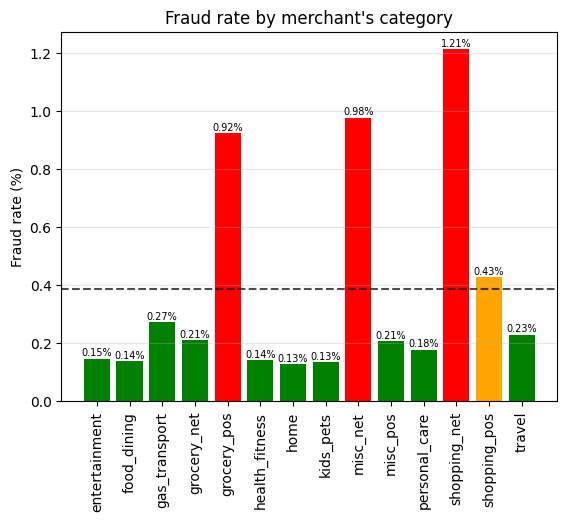

In [12]:
plt.figure()
colors = ['red' if rate > total_fraud_rate + 0.05 else 'orange' if rate > total_fraud_rate
              else 'darkgreen' if rate < total_fraud_rate - 0.55 else 'green'
              for rate in category_fraud_rate]

plt.bar(category_name, category_fraud_rate, color=colors)
plt.title("Fraud rate by merchant's category")
plt.ylabel("Fraud rate (%)")
plt.axhline(y=total_fraud_rate, color='black', linestyle='--', alpha=0.7)
plt.grid(True, axis='y', alpha=0.3)
plt.xticks(rotation=90)

for i, rate in enumerate(category_fraud_rate):
    plt.text(i, rate + 0.01, f"{rate:.2f}%", ha='center', fontsize=7)

plt.show()


In [13]:
# Analysis fraud by day
df['trans_date_trans_time'] = pd.to_datetime(df['trans_date_trans_time'], format = "%Y-%m-%d %H:%M:%S")
df['DayOfWeek'] = df['trans_date_trans_time'].dt.day_name()

#Tidy up the days of the week
days_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Create new columns to understand the distribution of data based on days of the week
day_name, day_total, day_fraud, day_fraud_rate, day_avg_amt = [], [], [], [], []

print("Day-by-day fraud analysis:")
print("---------------------------------------------------------------")
print("Day        | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount")

for day in days_order:
    day_data = df[df['DayOfWeek'] == day]
    total = len(day_data)
    nb_frauds = len(day_data[day_data['is_fraud'] == 1])
    fraud_rate = (nb_frauds/total * 100) if total > 0 else 0
    avg_fraud_amt = day_data.loc[day_data['is_fraud'] == 1, 'amt'].sum() / nb_frauds if nb_frauds > 0 else 0

    day_name.append(day)
    day_total.append(total)
    day_fraud.append(nb_frauds)
    day_fraud_rate.append(fraud_rate)
    day_avg_amt.append(avg_fraud_amt)

    print(f"{day:10} | {total:6} | {nb_frauds:9} | {fraud_rate:9.2f}% | {avg_fraud_amt:6.0f} $")


Day-by-day fraud analysis:
---------------------------------------------------------------
Day        | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount
Monday     | 115136 |       302 |      0.26% |    501 $
Tuesday    | 110113 |       331 |      0.30% |    557 $
Wednesday  |  52840 |       266 |      0.50% |    572 $
Thursday   |  59456 |       309 |      0.52% |    529 $
Friday     |  62806 |       297 |      0.47% |    493 $
Saturday   |  62270 |       266 |      0.43% |    502 $
Sunday     |  93098 |       374 |      0.40% |    541 $


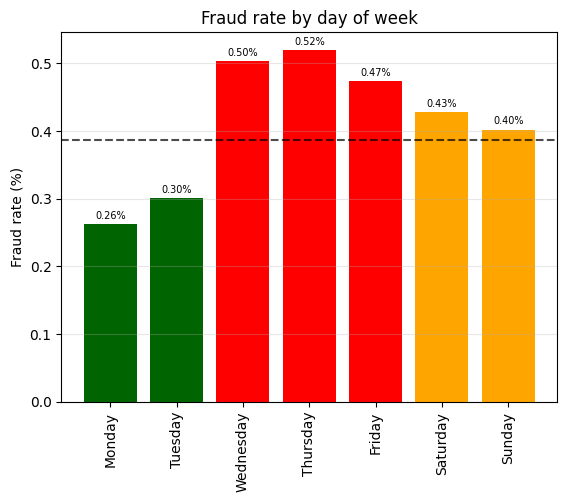

In [14]:
plt.figure()
colors = ['red' if rate > total_fraud_rate + 0.05 else 'orange' if rate > total_fraud_rate
              else 'darkgreen' if rate < total_fraud_rate - 0.05 else 'green'
              for rate in day_fraud_rate]

plt.bar(day_name, day_fraud_rate, color=colors)
plt.title("Fraud rate by day of week")
plt.ylabel("Fraud rate (%)")
plt.axhline(y=total_fraud_rate, color='black', linestyle='--', alpha=0.7)
plt.grid(True, axis='y', alpha=0.3)
plt.xticks(rotation=90)

for i, rate in enumerate(day_fraud_rate):
    plt.text(i, rate + 0.008, f"{rate:.2f}%", ha='center', fontsize=7)

plt.show()

In [15]:
# Analysis fraud by gender

genders = df['gender'].unique()
genders = sorted(genders)

# Create new columns to understand the distribution of data based on gender
gender_name, gender_total, gender_fraud, gender_fraud_rate, gender_avg_amt = [], [], [], [], []

print("Gender fraud analysis:")
print("-----------------------------------------------------------")
print("Gender | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount")

for gender in genders:
    gender_data = df[df['gender'] == gender]
    total = len(gender_data)
    nb_frauds = len(gender_data[gender_data['is_fraud'] == 1])
    fraud_rate = (nb_frauds/total * 100) if total > 0 else 0
    avg_fraud_amt = gender_data.loc[gender_data['is_fraud'] == 1, 'amt'].sum() / nb_frauds if nb_frauds > 0 else 0

    gender_name.append(gender)
    gender_total.append(total)
    gender_fraud.append(nb_frauds)
    gender_fraud_rate.append(fraud_rate)
    gender_avg_amt.append(avg_fraud_amt)

    print(f"{gender:6} | {total:6} | {nb_frauds:9} | {fraud_rate:9.2f}% | {avg_fraud_amt:6.0f} $")

Gender fraud analysis:
-----------------------------------------------------------
Gender | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount
F      | 304886 |      1164 |      0.38% |    479 $
M      | 250833 |       981 |      0.39% |    587 $


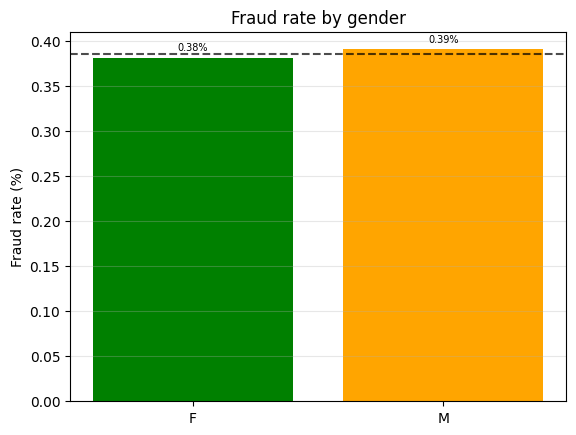

In [16]:
plt.figure()
colors = ['red' if rate > total_fraud_rate + 0.05 else 'orange' if rate > total_fraud_rate
              else 'darkgreen' if rate < total_fraud_rate - 0.05 else 'green'
              for rate in gender_fraud_rate]

plt.bar(gender_name, gender_fraud_rate, color=colors)
plt.title("Fraud rate by gender")
plt.ylabel("Fraud rate (%)")
plt.axhline(y=total_fraud_rate, color='black', linestyle='--', alpha=0.7)
plt.grid(True, axis='y', alpha=0.3)
plt.xticks(rotation=0)

for i, rate in enumerate(gender_fraud_rate):
    plt.text(i, rate + 0.008, f"{rate:.2f}%", ha='center', fontsize=7)

plt.show()

In [17]:
# Analysis fraud by lenght_ccnum

lenghts = df['lenght_cc_num'].unique()
lenghts = sorted(lenghts)

# Create new columns to understand the distribution of data based on gender
lenght_name, lenght_total, lenght_fraud, lenght_fraud_rate, lenght_avg_amt = [], [], [], [], []

print("Lenght_ccnum fraud analysis:")
print("-----------------------------------------------------------")
print("Lenght | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount")

for lenght in lenghts:
    lenght_data = df[df['lenght_cc_num'] == lenght]
    total = len(lenght_data)
    nb_frauds = len(lenght_data[lenght_data['is_fraud'] == 1])
    fraud_rate = (nb_frauds/total * 100) if total > 0 else 0
    avg_fraud_amt = lenght_data.loc[lenght_data['is_fraud'] == 1, 'amt'].sum() / nb_frauds if nb_frauds > 0 else 0

    lenght_name.append(lenght.astype(str))
    lenght_total.append(total)
    lenght_fraud.append(nb_frauds)
    lenght_fraud_rate.append(fraud_rate)
    lenght_avg_amt.append(avg_fraud_amt)

    print(f"{lenght:6} | {total:6} | {nb_frauds:9} | {fraud_rate:9.2f}% | {avg_fraud_amt:6.0f} $")

Lenght_ccnum fraud analysis:
-----------------------------------------------------------
Lenght | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount
    11 |   2708 |        20 |      0.74% |    622 $
    12 |  38844 |       179 |      0.46% |    600 $
    13 |  38246 |       145 |      0.38% |    520 $
    14 |  53989 |       244 |      0.45% |    506 $
    15 |  92810 |       416 |      0.45% |    540 $
    16 | 278140 |       963 |      0.35% |    531 $
    19 |  50982 |       178 |      0.35% |    441 $


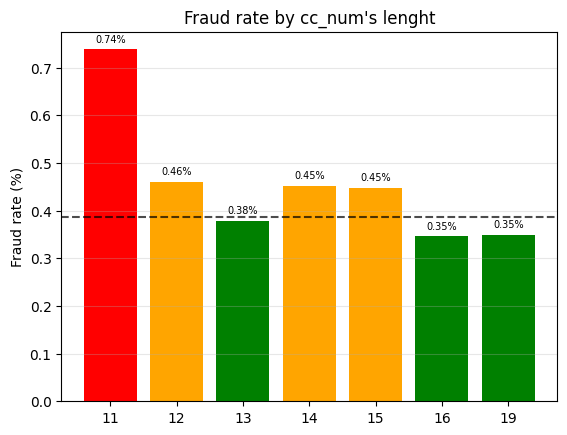

In [18]:
plt.figure()
colors = ['red' if rate > total_fraud_rate + 0.1 else 'orange' if rate > total_fraud_rate
              else 'darkgreen' if rate < total_fraud_rate - 0.1 else 'green'
              for rate in lenght_fraud_rate]

plt.bar(lenght_name, lenght_fraud_rate, color=colors)
plt.title("Fraud rate by cc_num's lenght")
plt.ylabel("Fraud rate (%)")
plt.axhline(y=total_fraud_rate, color='black', linestyle='--', alpha=0.7)
plt.grid(True, axis='y', alpha=0.3)
plt.xticks(rotation=0)

for i, rate in enumerate(lenght_fraud_rate):
    plt.text(i, rate + 0.015, f"{rate:.2f}%", ha='center', fontsize=7)

plt.show()

In [19]:
# Analysis fraud by distance

distance_bins = [0, 20, 40, 60, 80, 100, 120, 140, 999]
distance_labels = ["< 20 km", "20-40 km", "40-60 km", "60-80 km", "80-100 km", "100-120 km", "120-140 km", "> 140 km"]


#df['binned'] = pd.cut(df['distance_km'], bins=bins, labels=False)
df['binned'] = pd.cut(df['distance_km'], bins=distance_bins, labels=distance_labels)

distances = df['binned'].unique()
#distances = sorted(binned)

# Create new columns to understand the distribution of data based on gender
distance_name, distance_total, distance_fraud, distance_fraud_rate, distance_avg_amt = [], [], [], [], []

print("Distance fraud analysis:")
print("---------------------------------------------------------------")
print("Distance   | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount")

for distance in distances:
    distance_data = df[df['binned'] == distance]
    total = len(distance_data)
    nb_frauds = len(distance_data[distance_data['is_fraud'] == 1])
    fraud_rate = (nb_frauds/total * 100) if total > 0 else 0
    avg_fraud_amt = distance_data.loc[distance_data['is_fraud'] == 1, 'amt'].sum() / nb_frauds if nb_frauds > 0 else 0

    distance_name.append(distance)
    distance_total.append(total)
    distance_fraud.append(nb_frauds)
    distance_fraud_rate.append(fraud_rate)
    distance_avg_amt.append(avg_fraud_amt)

    print(f"{distance:10} | {total:6} | {nb_frauds:9} | {fraud_rate:9.2f}% | {avg_fraud_amt:6.0f} $")


Distance fraud analysis:
---------------------------------------------------------------
Distance   | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount
20-40 km   |  54765 |       221 |      0.40% |    576 $
100-120 km | 100637 |       379 |      0.38% |    512 $
40-60 km   |  90682 |       331 |      0.37% |    520 $
80-100 km  | 135209 |       537 |      0.40% |    551 $
120-140 km |  28583 |       112 |      0.39% |    471 $
60-80 km   | 127101 |       493 |      0.39% |    515 $
< 20 km    |  18133 |        68 |      0.38% |    531 $
> 140 km   |    609 |         4 |      0.66% |    322 $


In [20]:
# toto = df[df['binned'].isna()]
# toto.head()

<Figure size 640x480 with 0 Axes>

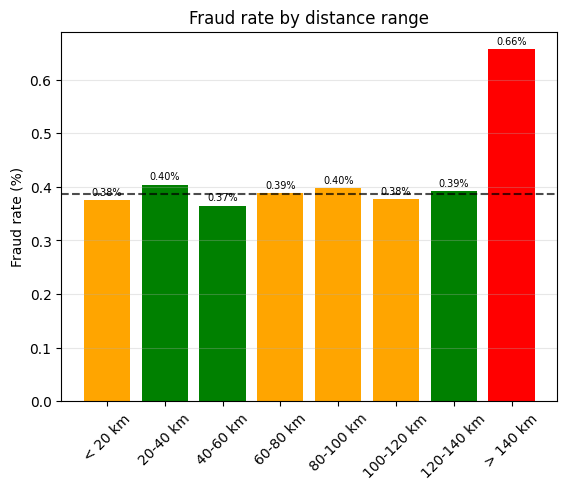

In [21]:
plt.figure()

colors = ['red' if rate > total_fraud_rate + 0.03 else 'orange' if rate > total_fraud_rate
              else 'darkgreen' if rate < total_fraud_rate - 0.03 else 'green'
              for rate in distance_fraud_rate]

distance_stats = df.groupby(df.binned)['is_fraud'].value_counts(normalize=True).unstack().fillna(0)
distance_fraud_rate = distance_stats.get(1, 0) * 100

plt.figure()
plt.bar(distance_fraud_rate.index.astype(str), distance_fraud_rate.values, color=colors)
plt.title("Fraud rate by distance range")
#plt.xlabel("Distance")
plt.ylabel("Fraud rate (%)")
plt.axhline(y=total_fraud_rate, color='black', linestyle='--', alpha=0.7)
plt.grid(True, axis='y', alpha=0.3)
plt.xticks(rotation=45)

for i, rate in enumerate(distance_fraud_rate.values):
    plt.text(i, rate + 0.01, f"{rate:.2f}%", ha='center', fontsize=7)

plt.show()

In [22]:
# Analysis fraud by age

age_bins = [0, 20, 30, 40, 50, 60, 70, 80, 90, 100, 999]
age_labels = ["< 20 ans", "20-30 ans", "30-40 ans", "40-50 ans", "50-60 ans", "60-70 ans", "70-80 ans", "80-90 ans", "90-100 ans", "> 100 ans"]


df['age_binned'] = pd.cut(df['age'], bins=age_bins, labels=age_labels)

ages = df['age_binned'].unique()


# Create new columns to understand the distribution of data based on gender
age_name, age_total, age_fraud, age_fraud_rate, age_avg_amt = [], [], [], [], []

print("Age fraud analysis:")
print("---------------------------------------------------------------")
print("Age        | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount")

for age in ages:
    age_data = df[df['age_binned'] == age]
    total = len(age_data)
    nb_frauds = len(age_data[age_data['is_fraud'] == 1])
    fraud_rate = (nb_frauds/total * 100) if total > 0 else 0
    avg_fraud_amt = age_data.loc[age_data['is_fraud'] == 1, 'amt'].sum() / nb_frauds if nb_frauds > 0 else 0

    age_name.append(age)
    age_total.append(total)
    age_fraud.append(nb_frauds)
    age_fraud_rate.append(fraud_rate)
    age_avg_amt.append(avg_fraud_amt)

    print(f"{age:10} | {total:6} | {nb_frauds:9} | {fraud_rate:9.2f}% | {avg_fraud_amt:6.0f} $")


Age fraud analysis:
---------------------------------------------------------------
Age        | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount
50-60 ans  | 111574 |       424 |      0.38% |    512 $
30-40 ans  | 123121 |       455 |      0.37% |    502 $
60-70 ans  |  69359 |       341 |      0.49% |    568 $
70-80 ans  |  43801 |       216 |      0.49% |    566 $
20-30 ans  |  50121 |       163 |      0.33% |    610 $
40-50 ans  | 115391 |       376 |      0.33% |    466 $
80-90 ans  |  23855 |       120 |      0.50% |    562 $
90-100 ans |  16198 |        43 |      0.27% |    618 $
> 100 ans  |    199 |         7 |      3.52% |    491 $
< 20 ans   |   2100 |         0 |      0.00% |      0 $


<Figure size 640x480 with 0 Axes>

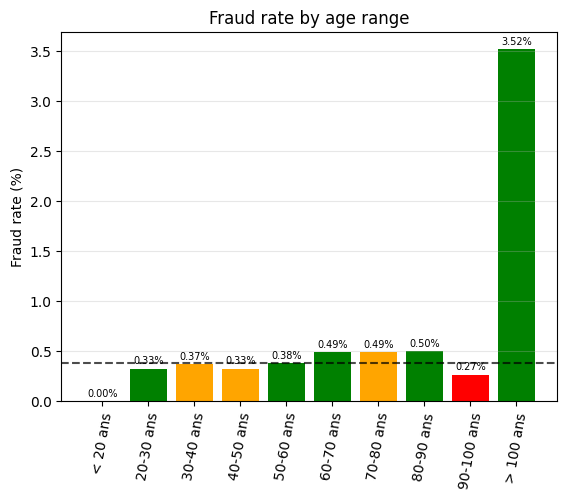

In [23]:
# Analysis fraud by age

plt.figure()

colors = ['red' if rate > total_fraud_rate + 2.5 else 'orange' if rate > total_fraud_rate
              else 'darkgreen' if rate < total_fraud_rate - 2.5 else 'green'
              for rate in age_fraud_rate]

age_stats = df.groupby(df.age_binned)['is_fraud'].value_counts(normalize=True).unstack().fillna(0)
age_fraud_rate = age_stats.get(1, 0) * 100

plt.figure()
plt.bar(age_fraud_rate.index.astype(str), age_fraud_rate.values, color=colors)
plt.title("Fraud rate by age range")
#plt.xlabel("Age")
plt.ylabel("Fraud rate (%)")
plt.axhline(y=total_fraud_rate, color='black', linestyle='--', alpha=0.7)
plt.grid(True, axis='y', alpha=0.3)
plt.xticks(rotation=80)

for i, rate in enumerate(age_fraud_rate.values):
    plt.text(i, rate + 0.05, f"{rate:.2f}%", ha='center', fontsize=7)

plt.show()

In [24]:
# Analysis fraud by city_pop

pop_bins = [0, 100000, 200000, 300000, 400000, 500000, 600000, 700000, 800000, 900000, 1000000, 9999999]
pop_labels = ["< 0.1 M", "0.1-0.2 M", "0.2-0.3 M", "0.3-0.4 M","0.4-0.5 M", "0.5-0.6 M", "0.6-0.7 M", "0.7-0.8 M", "0.8-0.9 M", "0.9-1.0 M", "> 1.0 M"]

 
df['pop_binned'] = pd.cut(df['city_pop'], bins=pop_bins, labels=pop_labels)
pops = df['pop_binned'].unique()


# Create new columns to understand the distribution of data based on gender
pop_name, pop_total, pop_fraud, pop_fraud_rate, pop_avg_amt = [], [], [], [], []

print("Population fraud analysis:")
print("---------------------------------------------------------------")
print("Population | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount")

for pop in pops:
    pop_data = df[df['pop_binned'] == pop]
    total = len(pop_data)
    nb_frauds = len(pop_data[pop_data['is_fraud'] == 1])
    fraud_rate = (nb_frauds/total * 100) if total > 0 else 0
    avg_fraud_amt = pop_data.loc[pop_data['is_fraud'] == 1, 'amt'].sum() / nb_frauds if nb_frauds > 0 else 0

    pop_name.append(pop)
    pop_total.append(total)
    pop_fraud.append(nb_frauds)
    pop_fraud_rate.append(fraud_rate)
    pop_avg_amt.append(avg_fraud_amt)

    print(f"{pop:10} | {total:6} | {nb_frauds:9} | {fraud_rate:9.2f}% | {avg_fraud_amt:6.0f} $")


Population fraud analysis:
---------------------------------------------------------------
Population | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount
0.3-0.4 M  |   6684 |         7 |      0.10% |    142 $
< 0.1 M    | 479803 |      1937 |      0.40% |    523 $
0.1-0.2 M  |  24501 |        46 |      0.19% |    506 $
0.5-0.6 M  |   1746 |         0 |      0.00% |      0 $
> 1.0 M    |  14046 |        39 |      0.28% |    541 $
0.4-0.5 M  |   4366 |        11 |      0.25% |    735 $
0.6-0.7 M  |   4808 |        17 |      0.35% |    634 $
0.2-0.3 M  |  12337 |        55 |      0.45% |    673 $
0.9-1.0 M  |   3103 |         0 |      0.00% |      0 $
0.7-0.8 M  |   3250 |        12 |      0.37% |    593 $
0.8-0.9 M  |   1075 |        21 |      1.95% |    596 $


<Figure size 640x480 with 0 Axes>

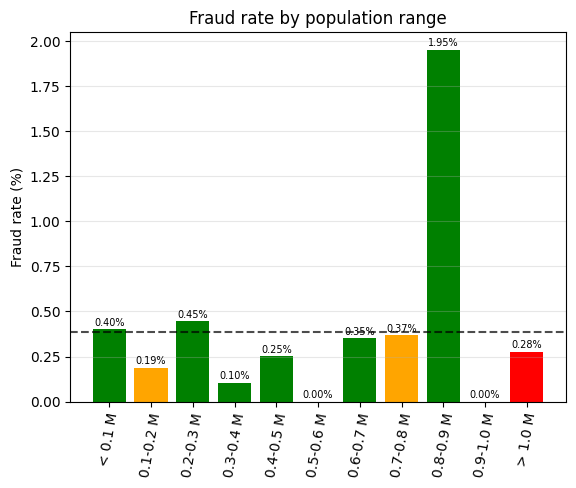

In [25]:
# Analysis fraud by city_pop

plt.figure()

colors = ['red' if rate > total_fraud_rate + 0.5 else 'orange' if rate > total_fraud_rate
              else 'darkgreen' if rate < total_fraud_rate - 0.5 else 'green'
              for rate in pop_fraud_rate]


pop_stats = df.groupby(df.pop_binned)['is_fraud'].value_counts(normalize=True).unstack().fillna(0)
pop_fraud_rate = pop_stats.get(1, 0) * 100

plt.figure()
plt.bar(pop_fraud_rate.index.astype(str), pop_fraud_rate.values, color=colors)
plt.title("Fraud rate by population range")
#plt.xlabel("Population")
plt.ylabel("Fraud rate (%)")
plt.axhline(y=total_fraud_rate, color='black', linestyle='--', alpha=0.7)
plt.grid(True, axis='y', alpha=0.3)
plt.xticks(rotation=80)

for i, rate in enumerate(pop_fraud_rate.values):
    plt.text(i, rate + 0.02, f"{rate:.2f}%", ha='center', fontsize=7)

plt.show()

In [26]:
# Analysis fraud by amount

amt_bins = [0, 100, 200, 300, 400, 500, 600, 700, 800, 900, 1000, 99999]
amt_labels = ["< 100 $", "100-200 $", "200-300 $", "300-400 $","400-500 $", "500-600 $", "600-700 $", "700-800 $", "800-900 $", "900-1000 $", "> 1000 $"]

 
df['amt_binned'] = pd.cut(df['amt'], bins=amt_bins, labels=amt_labels)
amts = df['amt_binned'].unique()


# Create new columns to understand the distribution of data based on gender
amt_name, amt_total, amt_fraud, amt_fraud_rate, amt_avg_amt = [], [], [], [], []

print("Amount fraud analysis:")
print("---------------------------------------------------------------")
print("Amount     | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount")

for amt in amts:
    amt_data = df[df['amt_binned'] == amt]
    total = len(amt_data)
    nb_frauds = len(amt_data[amt_data['is_fraud'] == 1])
    fraud_rate = (nb_frauds/total * 100) if total > 0 else 0
    avg_fraud_amt = amt_data.loc[amt_data['is_fraud'] == 1, 'amt'].sum() / nb_frauds if nb_frauds > 0 else 0

    amt_name.append(amt)
    amt_total.append(total)
    amt_fraud.append(nb_frauds)
    amt_fraud_rate.append(fraud_rate)
    amt_avg_amt.append(avg_fraud_amt)

    print(f"{amt:10} | {total:6} | {nb_frauds:9} | {fraud_rate:9.2f}% | {avg_fraud_amt:6.0f} $")


Amount fraud analysis:
---------------------------------------------------------------
Amount     | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount
< 100 $    | 455734 |       480 |      0.11% |     17 $
100-200 $  |  74636 |        54 |      0.07% |    127 $
200-300 $  |  13203 |       212 |      1.61% |    274 $
500-600 $  |   1912 |        31 |      1.62% |    553 $
> 1000 $   |   1583 |       276 |     17.44% |   1076 $
400-500 $  |   2593 |        23 |      0.89% |    457 $
300-400 $  |   3475 |       340 |      9.78% |    328 $
600-700 $  |    842 |        47 |      5.58% |    663 $
700-800 $  |    632 |       165 |     26.11% |    754 $
900-1000 $ |    527 |       275 |     52.18% |    954 $
800-900 $  |    582 |       242 |     41.58% |    851 $


In [27]:
# Analysis fraud by hour

hour_bins = [0, 3, 12, 21, 23, 99]
hour_labels = ["00:00-03:00", "03:00-12:00", "12:00-21:00", "21:00-23:00", "23:00-00:00" ]


df['hour_binned'] = pd.cut(df['hour'], bins=hour_bins, labels=hour_labels) 
hours = df['hour_binned'].unique()

# Create new columns to understand the distribution of data based on gender
hour_name, hour_total, hour_fraud, hour_fraud_rate, hour_avg_amt = [], [], [], [], []

print("Hour fraud analysis:")
print("----------------------------------------------------------------")
print("Hour        | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount")

for hour in hours:
    hour_data = df[df['hour_binned'] == hour]
    total = len(hour_data)
    nb_frauds = len(hour_data[hour_data['is_fraud'] == 1])
    fraud_rate = (nb_frauds/total * 100) if total > 0 else 0
    avg_fraud_amt = hour_data.loc[hour_data['is_fraud'] == 1, 'amt'].sum() / nb_frauds if nb_frauds > 0 else 0

    hour_name.append(hour)
    hour_total.append(total)
    hour_fraud.append(nb_frauds)
    hour_fraud_rate.append(fraud_rate)
    hour_avg_amt.append(avg_fraud_amt)

    print(f"{hour:4} | {total:6} | {nb_frauds:9} | {fraud_rate:9.2f}% | {avg_fraud_amt:6.0f} $")


Hour fraud analysis:
----------------------------------------------------------------
Hour        | Total  | Nb_frauds | Fraud_rate | Avg_fraud_amount
03:00-12:00 | 172409 |       135 |      0.08% |    383 $
12:00-21:00 | 253171 |       203 |      0.08% |    601 $
21:00-23:00 |  57186 |      1088 |      1.90% |    637 $
 nan |      0 |         0 |      0.00% |      0 $
00:00-03:00 |  54800 |       531 |      0.97% |    380 $


<Figure size 640x480 with 0 Axes>

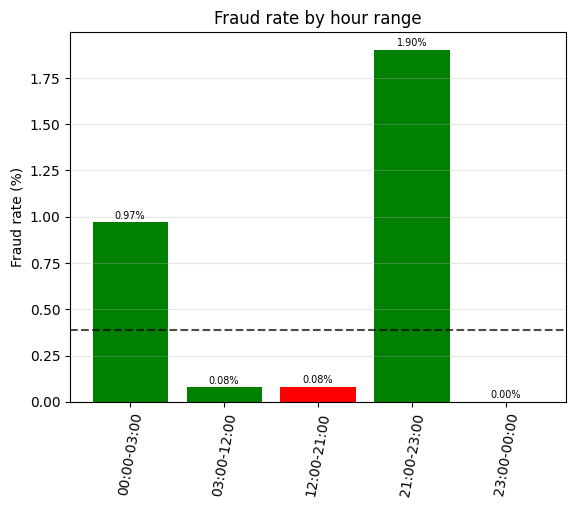

In [28]:
# Analysis fraud by hour

plt.figure()

colors = ['red' if rate > total_fraud_rate + 1.0 else 'orange' if rate > total_fraud_rate
              else 'darkgreen' if rate < total_fraud_rate - 1.0 else 'green'
              for rate in hour_fraud_rate]


hour_stats = df.groupby(df.hour_binned)['is_fraud'].value_counts(normalize=True).unstack().fillna(0)
hour_fraud_rate = hour_stats.get(1, 0) * 100

plt.figure()
plt.bar(hour_fraud_rate.index.astype(str), hour_fraud_rate.values, color=colors)
plt.title("Fraud rate by hour range")
#plt.xlabel("Population")
plt.ylabel("Fraud rate (%)")
plt.axhline(y=total_fraud_rate, color='black', linestyle='--', alpha=0.7)
plt.grid(True, axis='y', alpha=0.3)
plt.xticks(rotation=80)

for i, rate in enumerate(hour_fraud_rate.values):
    plt.text(i, rate + 0.02, f"{rate:.2f}%", ha='center', fontsize=7)

plt.show()

<Figure size 640x480 with 0 Axes>

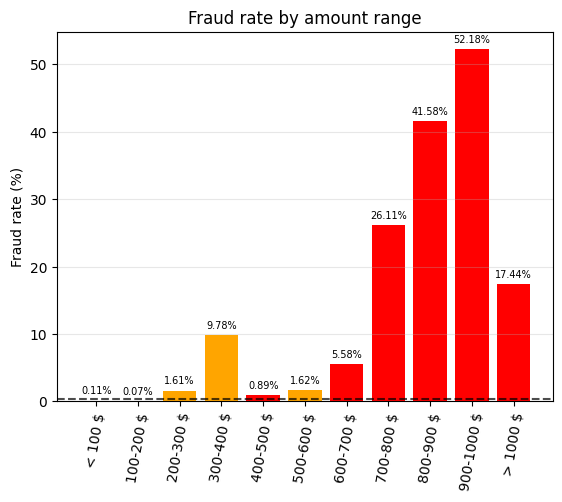

In [29]:
# Analysis fraud by amount

plt.figure()

colors = ['red' if rate > total_fraud_rate + 2 else 'orange' if rate > total_fraud_rate
              else 'darkgreen' if rate < total_fraud_rate - 2 else 'green'
              for rate in amt_fraud_rate]


amt_stats = df.groupby(df.amt_binned)['is_fraud'].value_counts(normalize=True).unstack().fillna(0)
amt_fraud_rate = amt_stats.get(1, 0) * 100

plt.figure()
plt.bar(amt_fraud_rate.index.astype(str), amt_fraud_rate.values, color=colors)
plt.title("Fraud rate by amount range")
#plt.xlabel("Age")
plt.ylabel("Fraud rate (%)")
plt.axhline(y=total_fraud_rate, color='black', linestyle='--', alpha=0.7)
plt.grid(True, axis='y', alpha=0.3)
plt.xticks(rotation=80)

for i, rate in enumerate(amt_fraud_rate.values):
    plt.text(i, rate + 1.0, f"{rate:.2f}%", ha='center', fontsize=7)

plt.show()

In [30]:
df_fraud = df[df.is_fraud == 1]

In [31]:
fig = px.scatter_map(df_fraud, lat='lat', lon= 'long', color= 'amt',
                        map_style= "open-street-map", zoom = 1.5, color_continuous_scale= 'Reds')
fig.show()

In [32]:
df_fraud_hour = df_fraud.sort_values(by=['hour'])
fig = px.density_map(df_fraud_hour, lat='lat', lon= 'long',
                        map_style= "open-street-map", zoom = 2, radius= 10, animation_frame= 'hour')
fig.show()

In [33]:
df_fraud_hour = df_fraud.sort_values(by=['amt'])
fig = px.density_map(df_fraud_hour, lat='lat', lon= 'long',
                        map_style= "open-street-map", zoom = 2, radius= 10)
fig.show()

In [34]:
fig = go.Figure()

fig.add_trace(
    go.Histogram(
        x = df_fraud['category'].sort_values()))

fig.add_trace(
    go.Histogram(
        x = df_fraud['gender'].sort_values(),
        visible=False))

fig.add_trace(
    go.Histogram(
        x = df_fraud['state'].sort_values(),
        visible=False))

fig.add_trace(
    go.Histogram(
        x = df_fraud['weekday'].sort_values(),
        visible=False))

fig.add_trace(
    go.Histogram(
        x = df_fraud['hour'].sort_values(),
        visible=False))

fig.add_trace(
    go.Histogram(
        x = df_fraud['lenght_cc_num'].sort_values(),
        visible=False))

fig.add_trace(
    go.Histogram(
        x = df_fraud['age'].sort_values(),
        visible=False))

fig.update_layout(
    title = go.layout.Title(text = 'Exploring different variables on only frauds', x = 0.5),
    showlegend = False)

fig.update_layout(
    updatemenus = [go.layout.Updatemenu(
        active = 0,
        buttons = [
            go.layout.updatemenu.Button(
                label = 'category',
                method = 'update',
                args = [{"visible" : [True, False, False, False, False, False, False]}]),

            go.layout.updatemenu.Button(
                label = 'gender',
                method = 'update',
                args = [{"visible" : [False, True, False, False, False, False, False]}]),

            go.layout.updatemenu.Button(
                label = 'state',
                method = 'update',
                args = [{"visible" : [False, False, True, False, False, False, False]}]),

            go.layout.updatemenu.Button(
                label = 'weekday',
                method = 'update',
                args = [{"visible" : [False, False, False, True, False, False, False]}]),                             

            go.layout.updatemenu.Button(
                label = 'hour',
                method = 'update',
                args = [{"visible" : [False, False, False, False, True, False, False]}]),                             

            go.layout.updatemenu.Button(
                label = 'lenght_cc_num',
                method = 'update',
                args = [{"visible" : [False, False, False, False, False, True, False]}]),                             


            go.layout.updatemenu.Button(
                label = 'age',
                method = 'update',
                args = [{"visible" : [False, False, False, False, False, False, True]}])                    

                ]
    )]
)

In [35]:
# Average amt_fraud by category
df_category = df_fraud.groupby(['category','is_fraud'])['amt'].mean().reset_index()

# px.bar
fig = px.bar(df_category, x = 'category', y = 'amt', color = 'is_fraud')
fig.show(showlegend=False)

In [36]:
fig = px.pie(df_fraud, names = 'category', values = 'amt')
fig.show()

In [37]:
# df_fraud_sorted = (df_fraud.pivot_table(index='state', columns='is_fraud', values='amt', aggfunc='sum')).sort_values(1, ascending = False)
# display(df_fraud_sorted)


In [38]:
#pio.write_html(fig, 'toto.html')

In [39]:
# fig = px.scatter(df, x = 'hour', y = 'amt', color = df['is_fraud'].astype('str'), labels = {'color': 'is_fraud'})
# fig.show()

In [40]:
# Univariate analysis
# Distribution of each numeric variable
num_features = [c for c in df.columns if c != 'is_fraud']
cat_order = {
    'is_fraud': [0, 1]
}

def display_distribution(f):
    fig = px.histogram(df, f, color = 'is_fraud', facet_row = 'is_fraud', histnorm = 'probability', 
                       category_orders = cat_order)
    fig.show()
    
display_distribution('category')

In [41]:
#display_distribution('pop_binned')

In [42]:
# display_distribution('gender')

In [43]:
#display_distribution('weekday')

In [44]:
display_distribution('hour')

In [45]:
#display_distribution('lenght_cc_num')

In [46]:
#display_distribution('age_binned')

In [47]:
#isplay_distribution('binned')

#### 5. Preprocessing

In [48]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, FunctionTransformer, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier


In [114]:
# Import data
print("🏃 Loading dataset...")
df = pd.read_csv("C:/Users/Jedha1/Desktop/Bloc_3_Fraud_Detection/data/fraudTest.csv", index_col=0)
df = df.astype({col: "float64" for col in df.select_dtypes(include=["int"]).columns})

🏃 Loading dataset...


In [115]:
## Features engineering
      
# Extract date information
df['weekday'] = pd.to_datetime(df['trans_date_trans_time']).dt.day_name()
df['hour'] = pd.to_datetime(df['trans_date_trans_time']).dt.hour

# Enrichment with lenght of credit card number
df['cc_num'] = df['cc_num'].astype(str)
df['lenght_cc_num'] = df['cc_num'].str.len()

# Convert date of birthday in age (from today)
df['age'] = pd.to_datetime('today').date().year - pd.to_datetime(df['dob']).dt.year

# Enrichment with distance (kms) between customer and merchant
def haversine(long, merch_long, lat, merch_lat):
    # Convert degrees to radians
    long, merch_long, lat, merch_lat = map(np.radians, [long, merch_long, lat, merch_lat])
    diff_lon = merch_long - long
    diff_lat = merch_lat - lat
    # earth radius: 6371 kms
    distance_km = 2*6371*np.arcsin(np.sqrt(np.sin(diff_lat/2.0)**2 + np.cos(lat) * np.cos(merch_lat) \
                                        * np.sin(diff_lon/2.0)**2))
    return distance_km
df.loc[:, 'distance_km'] = df.apply(lambda x: haversine(x['long'], x['merch_long'], x['lat'], x['merch_lat']), axis = 1)

# Anonymize (because of compliance) and drop useless data (or too many categories)
useless_columns= ['trans_date_trans_time', 'cc_num', 'merchant', 'first', 'last', 'gender', 'street',
                    'city', 'zip', 'state', 'lat', 'long', 'job', 'dob', 'trans_num', 'unix_time',
                    'merch_lat', 'merch_long']

df = df.drop(useless_columns, axis=1)
df = df.astype({col: "float64" for col in df.select_dtypes(include=["int"]).columns})



In [116]:
# Separate target variable y from features X
print("🏃 Separating labels from features...")
X = df.drop("is_fraud", axis=1)
y = df["is_fraud"]


🏃 Separating labels from features...


In [117]:
# Automatically detect names of numeric/categorical columns
numeric_features = []
categorical_features = []
for i,t in X.dtypes.items():
    if ('float' in str(t)) or ('int' in str(t)) :
        numeric_features.append(i)
    else :
        categorical_features.append(i)

print('Found numeric features ', numeric_features)
print('Found categorical features ', categorical_features)

Found numeric features  ['amt', 'city_pop', 'hour', 'lenght_cc_num', 'age', 'distance_km']
Found categorical features  ['category', 'weekday']


In [124]:
# Divide data Train set & Test set with test_size = 0.2 (20%)
print("🏃 Dividing into train and test sets...")
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify = y, random_state=42)

🏃 Dividing into train and test sets...


In [125]:
# Preprocessing 
print("🏃 Preprocessing pipeline...")

# Create pipeline for numeric features
numeric_transformer = StandardScaler()

# Create pipeline for categorical features
categorical_transformer = OneHotEncoder(drop='first') # no missing values 


preprocessor = ColumnTransformer(
    transformers=[
        ("categorical_transformer", categorical_transformer, categorical_features),
        ("numeric_transformer", numeric_transformer, numeric_features)
    ]
)

# Preprocessings on train set
print("Performing preprocessings on train set...")
X_train = preprocessor.fit_transform(X_train)

# Preprocessings on test set
print("Performing preprocessings on test set...")
X_test = preprocessor.transform(X_test) # Don't fit again !! 


🏃 Preprocessing pipeline...
Performing preprocessings on train set...
Performing preprocessings on test set...


In [65]:
# ## Parse arguments given in shell script
# parser = argparse.ArgumentParser()
# parser.add_argument("--n_estimators", default=5)
# parser.add_argument("--min_samples_split", default=10)
# args = parser.parse_args()

In [128]:
## BASELINE : RANDOM FOREST CLASSIFIER
print("🎯 Machine Learning - Model Baseline : RANDOM FOREST CLASSIFIER")

# Perform grid search
print("Random Forest with default hyperparameters...")
regressor = RandomForestRegressor() # we must use a regressor here!
regressor.fit(X_train, y_train)

# Print R^2 scores
print("R2 score on training set : ", regressor.score(X_train, y_train))
print("R2 score on test set : ", regressor.score(X_test, y_test))


🎯 Machine Learning - Model Baseline : RANDOM FOREST CLASSIFIER
Random Forest with default hyperparameters...
R2 score on training set :  0.9592422727020604
R2 score on test set :  0.7074683052466658


##### OVERFITTING ! ########


In [130]:
# Perform grid search
print("Grid search...")
regressor = RandomForestRegressor()

# Grid of values to be tested
params = {
    'max_depth': [1, 2, 5],
    'min_samples_split': [6, 8, 10],
    'n_estimators': [2, 4, 6]
}
gridsearch = GridSearchCV(regressor, param_grid = params, cv = 3, verbose = 2)
gridsearch.fit(X_train, y_train)
print("...Done.")
print("Best hyperparameters : ", gridsearch.best_params_)
print("Best validation accuracy : ", gridsearch.best_score_)

Grid search...
Fitting 3 folds for each of 27 candidates, totalling 81 fits
[CV] END ...max_depth=1, min_samples_split=6, n_estimators=2; total time=   0.5s
[CV] END ...max_depth=1, min_samples_split=6, n_estimators=2; total time=   0.5s
[CV] END ...max_depth=1, min_samples_split=6, n_estimators=2; total time=   0.5s
[CV] END ...max_depth=1, min_samples_split=6, n_estimators=4; total time=   0.9s
[CV] END ...max_depth=1, min_samples_split=6, n_estimators=4; total time=   0.9s
[CV] END ...max_depth=1, min_samples_split=6, n_estimators=4; total time=   0.9s
[CV] END ...max_depth=1, min_samples_split=6, n_estimators=6; total time=   1.3s
[CV] END ...max_depth=1, min_samples_split=6, n_estimators=6; total time=   1.4s
[CV] END ...max_depth=1, min_samples_split=6, n_estimators=6; total time=   1.3s
[CV] END ...max_depth=1, min_samples_split=8, n_estimators=2; total time=   0.4s
[CV] END ...max_depth=1, min_samples_split=8, n_estimators=2; total time=   0.4s
[CV] END ...max_depth=1, min_samp

In [132]:
column_names = []
for name, step, features_list in preprocessor.transformers_: # loop over steps of ColumnTransformer
    if name == 'num': # if pipeline is for numeric variables
        features = features_list # just get the names of columns to which it has been applied
    else: # if pipeline is for categorical variables
        features = step.get_feature_names_out() # get output columns names from OneHotEncoder
    column_names.extend(features) # concatenate features names
        
print("Names of columns corresponding to each coefficient: ", column_names)

Names of columns corresponding to each coefficient:  ['category_food_dining', 'category_gas_transport', 'category_grocery_net', 'category_grocery_pos', 'category_health_fitness', 'category_home', 'category_kids_pets', 'category_misc_net', 'category_misc_pos', 'category_personal_care', 'category_shopping_net', 'category_shopping_pos', 'category_travel', 'weekday_Monday', 'weekday_Saturday', 'weekday_Sunday', 'weekday_Thursday', 'weekday_Tuesday', 'weekday_Wednesday', 'amt', 'city_pop', 'hour', 'lenght_cc_num', 'age', 'distance_km']


In [133]:
# Create a pandas DataFrame
feature_importance = pd.DataFrame(index = column_names, data = gridsearch.best_estimator_.feature_importances_, columns=["feature_importances"])
feature_importance = feature_importance.sort_values(by = 'feature_importances')

In [134]:
# Plot coefficients
fig = px.bar(feature_importance, orientation = 'h')
fig.update_layout(showlegend = False, 
                  margin = {'l': 120} # to avoid cropping of column names
                 )
fig.show()